In [6]:
import json
import pandas as pd
from bertopic import BERTopic
from sentence_transformers import SentenceTransformer
from hdbscan import HDBSCAN
from umap import UMAP
import os
import torch
import re
from sklearn.feature_extraction.text import CountVectorizer

In [7]:
# check device
device = "cuda" if torch.cuda.is_available() else "cpu"
print(f"目前使用的設備是: {device}")

目前使用的設備是: cuda


In [8]:
#######################
# 用來把留言中的url清除
#######################

def clean_text(text):
    # 1. 移除網址 (http, https, ftp, www)
    text = re.sub(r'http\S+|www\.\S+', '', text)
    # 2. 移除一些社群常見的雜訊 (可選)
    # 例如：移除重複的換行或多餘空格
    text = text.replace('\n', ' ').strip()
    return text

In [9]:
##############
# Read data
##############

input_file_name = "fb_comments.json"
platform_name = "fb"

with open(input_file_name, "r", encoding="utf-8") as f:
    comments_dict = json.load(f)
print(f"成功從{input_file_name}讀取檔案至comments_dict\n")


成功從fb_comments.json讀取檔案至comments_dict



In [23]:
############
# Settings
############

# 1. 向量化模型 (使用多語言支援)
embedding_model = SentenceTransformer("paraphrase-multilingual-MiniLM-L12-v2")

# 2. 降維模型 (UMAP): 影響分群的精細度
umap_model = UMAP(n_neighbors=15, n_components=5, min_dist=0.0, metric='cosine', random_state=42)

'''
# 3. 聚類模型 (HDBSCAN): 自動偵測分群
# min_cluster_size: 一個主題最少要有幾則留言 (可根據資料量調整)
hdbscan_model = HDBSCAN(min_cluster_size=len(comments_cleaned) * 0.05, metric='euclidean', cluster_selection_method='eom', prediction_data=True)
'''

# 4. 關鍵字提取 (Vectorizer): 排除停用詞
vectorizer_model = CountVectorizer(stop_words=["的", "了", "在", "是", "我", "https", "com"])



print("設定元件完畢")

設定元件完畢


2025-12-23 14:23:13,785 - BERTopic - Embedding - Transforming documents to embeddings.


成功提取出修杰楷的留言至comment_cleaned


Batches: 100%|██████████| 129/129 [00:14<00:00,  8.73it/s]
2025-12-23 14:23:28,594 - BERTopic - Embedding - Completed ✓
2025-12-23 14:23:28,594 - BERTopic - Dimensionality - Fitting the dimensionality reduction algorithm
2025-12-23 14:23:34,389 - BERTopic - Dimensionality - Completed ✓
2025-12-23 14:23:34,391 - BERTopic - Cluster - Start clustering the reduced embeddings
2025-12-23 14:23:34,583 - BERTopic - Cluster - Completed ✓
2025-12-23 14:23:34,583 - BERTopic - Representation - Fine-tuning topics using representation models.
2025-12-23 14:23:34,711 - BERTopic - Representation - Completed ✓


   Topic  Count                                      Name  \
0     -1   1005                  -1_xyz_org_hong_xiaoyang   
1      0    227      0_你的鐵粉和你_台灣人很健忘的_支持你的都是畜生_支持逃兵就是毀滅國家   
2      1     72               1_你說_好好面對吧_被抓了才在道歉_不是符合規定退役   
3      2     32              2_藝人也是人_一直檢討他_下一位血壓高_不代表不會犯錯   
4      3     31                3_好吃_超好吃_丹丹南部人的小確幸早餐_丹丹好吃嗎   
5      4     29  4_他不是有當替代役嗎_sassa_但是一開始想拼免役也是事實_他還是有當替代役   
6      5     27                 5_醫院_一堆人不覺得有什麼_一個字_不去抓詐騙犯   
7      6     27           6_逃兵仔_逃兵役_閃兵_下一波倒要看看有幾個黑熊仔青鳥仔被捉   
8      7     26   7_一個新聞的出現_一定是要蓋掉某些新聞_一般路人甲上新聞有人會關注嗎_不是阿   
9      8     26        8_僥倖心態_一種僥倖心理_ㄧ旦被抓到了也就把好好的家毀了_不再說謊   

                                      Representation  \
0  [xyz, org, hong, xiaoyang, 曾史丹, 林佳玉, tuidang, ...   
1  [你的鐵粉和你, 台灣人很健忘的, 支持你的都是畜生, 支持逃兵就是毀滅國家, 那些要你加油...   
2  [你說, 好好面對吧, 被抓了才在道歉, 不是符合規定退役, 不可原諒, 不主動出面承認道歉...   
3  [藝人也是人, 一直檢討他, 下一位血壓高, 不代表不會犯錯, 不用在乎那些酸民最後該補償該...   
4  [好吃, 超好吃, 丹丹南部人的小確幸早餐, 丹丹好吃嗎, 丹丹必吃, 丹丹漢堡, 丹丹漢

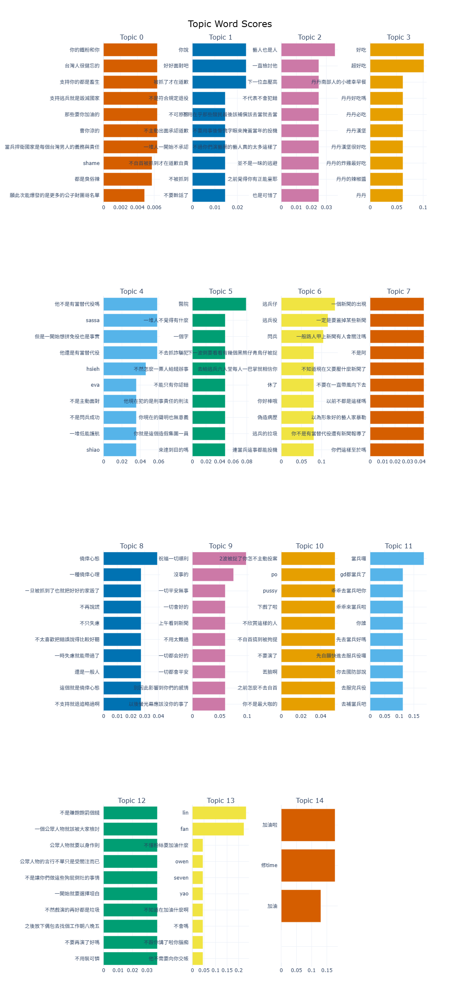

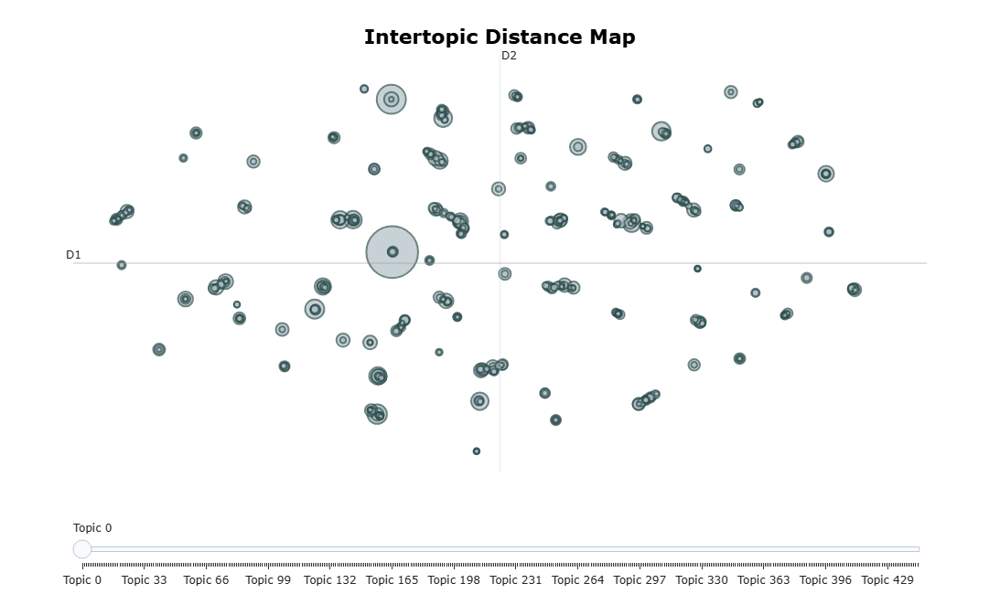

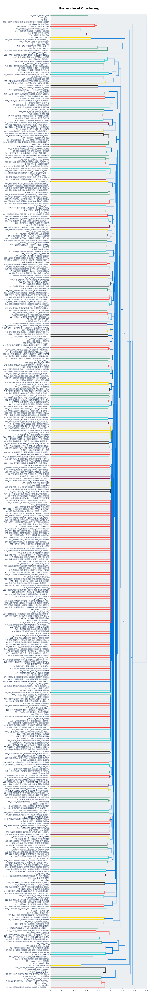

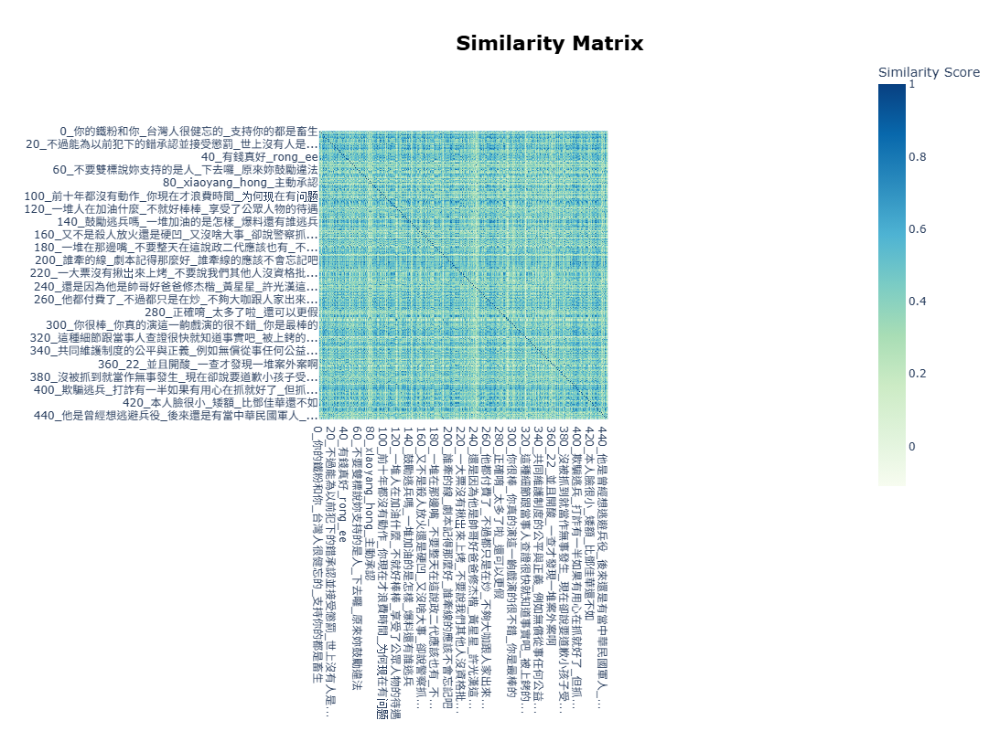

2025-12-23 14:23:36,718 - BERTopic - Embedding - Transforming documents to embeddings.


成功提取出廖允杰的留言至comment_cleaned


Batches: 100%|██████████| 11/11 [00:01<00:00,  7.76it/s]
2025-12-23 14:23:38,144 - BERTopic - Embedding - Completed ✓
2025-12-23 14:23:38,144 - BERTopic - Dimensionality - Fitting the dimensionality reduction algorithm
2025-12-23 14:23:38,636 - BERTopic - Dimensionality - Completed ✓
2025-12-23 14:23:38,637 - BERTopic - Cluster - Start clustering the reduced embeddings
2025-12-23 14:23:38,645 - BERTopic - Cluster - Completed ✓
2025-12-23 14:23:38,646 - BERTopic - Representation - Fine-tuning topics using representation models.
2025-12-23 14:23:38,657 - BERTopic - Representation - Completed ✓


   Topic  Count                                               Name  \
0     -1     75                           -1_為什麼要逃兵呢_百分之百_謝榮能_小杰加油   
1      0     26                            0_潘云熊_qq_不知道在加油三小_不然很難看   
2      1     24                       1_加油_一直都在_你們一起簽進去洗白比較快啦_你可以的   
3      2     21  2_被檢舉抓到後才承認真的很勇敢_犯刑法躲了十幾年_希望大家一直在一起_殘障逃兵團裡的污點閃...   
4      3     21                            3_不可原諒_之前在幹嘛_你才要坦承_來不及了   
5      4     21                          4_chen_sakura_minghui_wen   
6      5     19                                 5_沒事的_加油_一切都會好_你沒錯   
7      6     16                                 6_沒事_一定會沒事_ok的_下一位   
8      7     16                       7_不是在tv上說_令人唾棄_威廉被抓時_是因家族遺傳性   
9      8     15               8_不用理會酸民的話_不要箱信他們的話_不覺得你是公眾人物_不許你這樣說   

                                      Representation  \
0  [為什麼要逃兵呢, 百分之百, 謝榮能, 小杰加油, 林緯宸, 李慧昌, love, lin...   
1  [潘云熊, qq, 不知道在加油三小, 不然很難看, 一時失慮, 不紅還這麼多出頭, 了然,...   
2  [加油, 一直都在, 你們一起簽進去洗白比較快啦, 你可以的, 上車囉, 一起打倒民進黨, ...   
3  [被

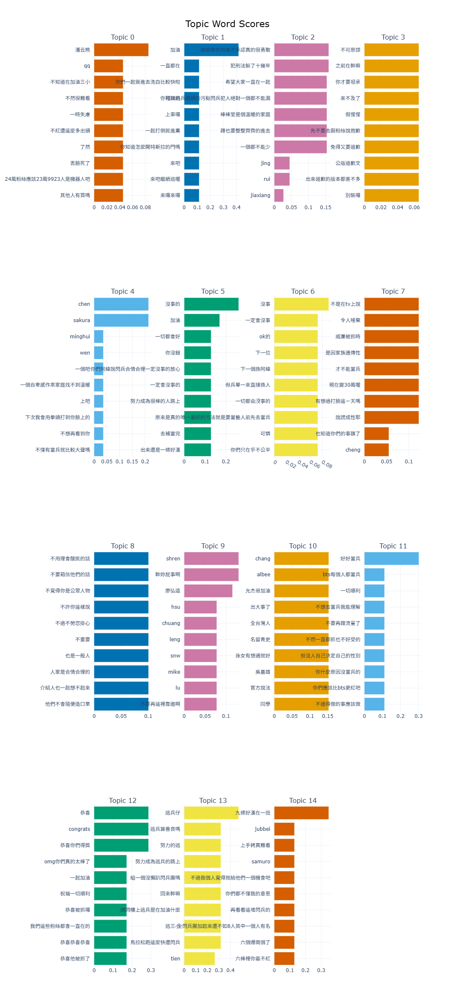

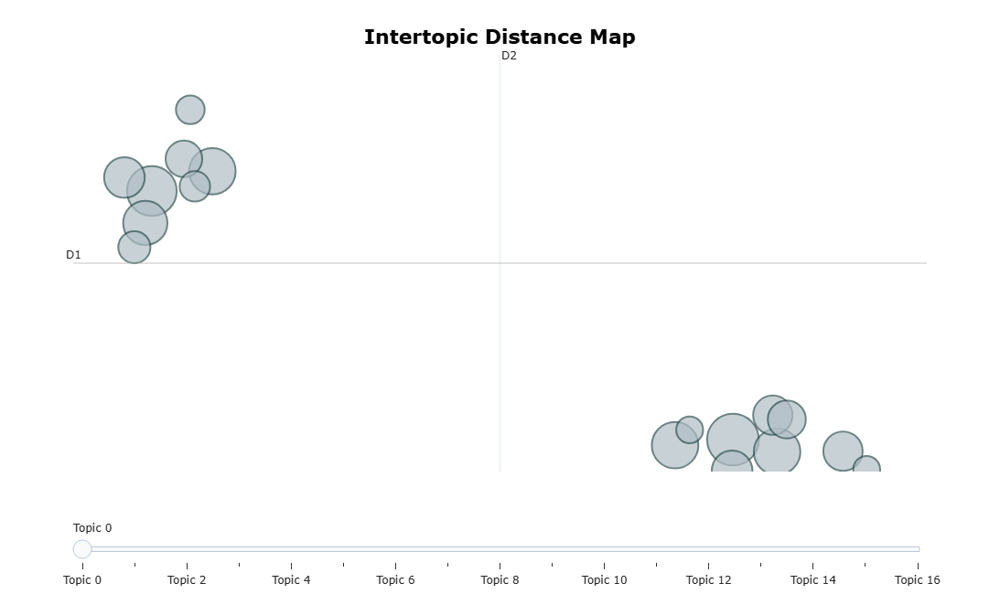

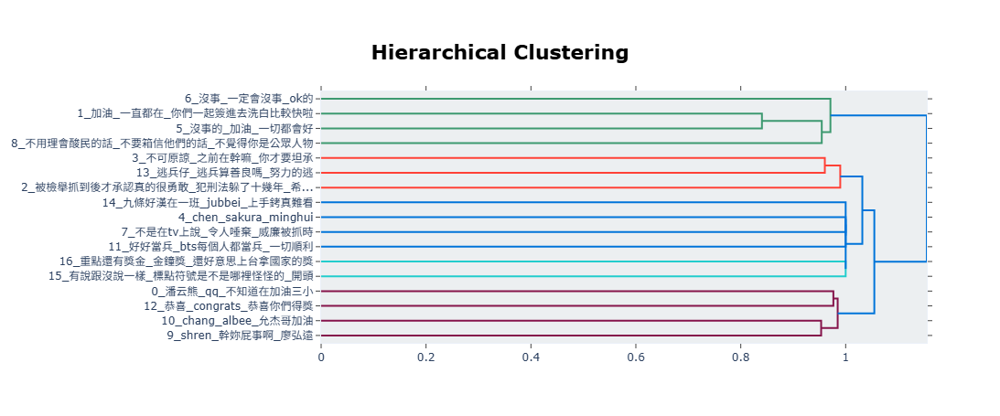

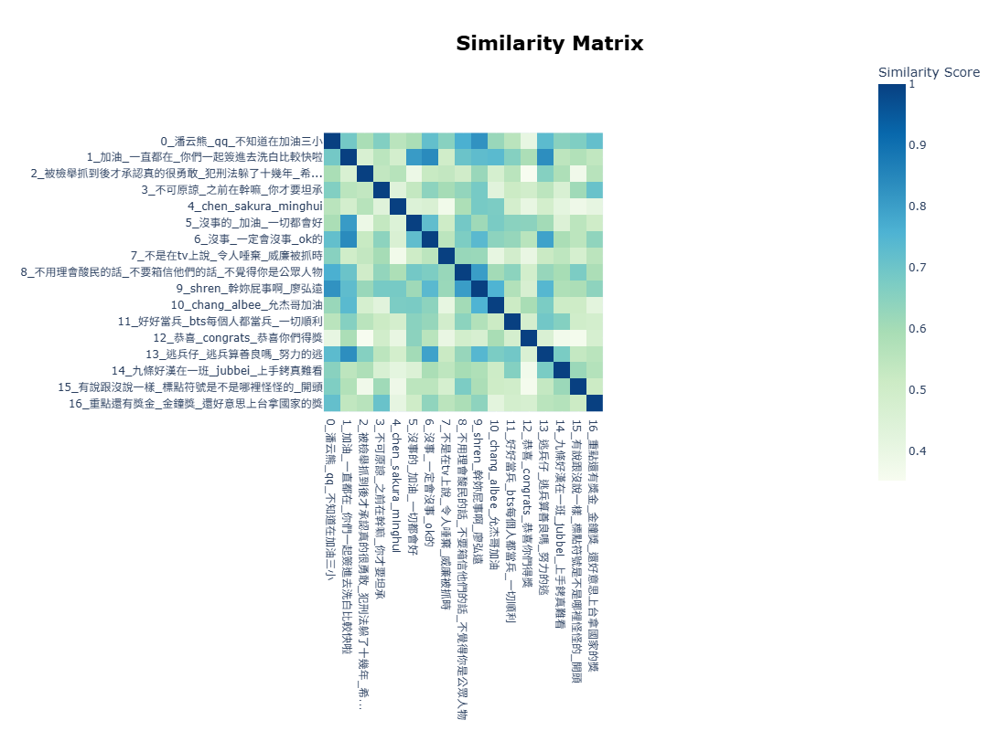

2025-12-23 14:23:39,069 - BERTopic - Embedding - Transforming documents to embeddings.


成功提取出張書偉的留言至comment_cleaned


Batches: 100%|██████████| 56/56 [00:05<00:00,  9.80it/s]
2025-12-23 14:23:44,806 - BERTopic - Embedding - Completed ✓
2025-12-23 14:23:44,807 - BERTopic - Dimensionality - Fitting the dimensionality reduction algorithm
2025-12-23 14:23:49,938 - BERTopic - Dimensionality - Completed ✓
2025-12-23 14:23:49,939 - BERTopic - Cluster - Start clustering the reduced embeddings
2025-12-23 14:23:49,994 - BERTopic - Cluster - Completed ✓
2025-12-23 14:23:49,998 - BERTopic - Representation - Fine-tuning topics using representation models.
2025-12-23 14:23:50,066 - BERTopic - Representation - Completed ✓


   Topic  Count                             Name  \
0     -1    437  -1_cheng_wu_黃薇潔_到底有多少x粉還是機器人在挺啊   
1      0    114        0_知錯能改_人都會犯錯_每個人都會犯錯_善莫大焉   
2      1     47         1_沒事啦_還不是沒去當兵_默默觀察_運動什麼啦   
3      2     44               2_書偉加油_洪舜文_張惴琳_書偉哥   
4      3     42            3_17小時_16小時_一起做公益_8小時   
5      4     41          4_沒事的_沒事_一切都會好起來的_你沒問題吧   
6      5     36            5_等你們回來_等你回來_哥加油_等你回歸   
7      6     36                 6_加油_加油唷_哥加油_加油喔   
8      7     34        7_勇敢面對_我們都在_一直支持著你們_不管怎麼樣   
9      8     31            8_chou_worry_don_iori   

                                      Representation  \
0  [cheng, wu, 黃薇潔, 到底有多少x粉還是機器人在挺啊, wa, liz, lo,...   
1  [知錯能改, 人都會犯錯, 每個人都會犯錯, 善莫大焉, 勇於認錯, 勇於面對錯誤, 承擔錯...   
2  [沒事啦, 還不是沒去當兵, 默默觀察, 運動什麼啦, 連當兵都在怕, 這是什麼事後諸葛的開...   
3                [書偉加油, 洪舜文, 張惴琳, 書偉哥, 加油, , , , , ]   
4  [17小時, 16小時, 一起做公益, 8小時, 18小時, 14小時, 15小時, 愛心不...   
5  [沒事的, 沒事, 一切都會好起來的, 你沒問題吧, 雨過天晴, 沒問題的, 沒關係啦, 你...   
6  [等你們回來, 等你回來, 哥加油, 等你回歸, 一直都在, 一

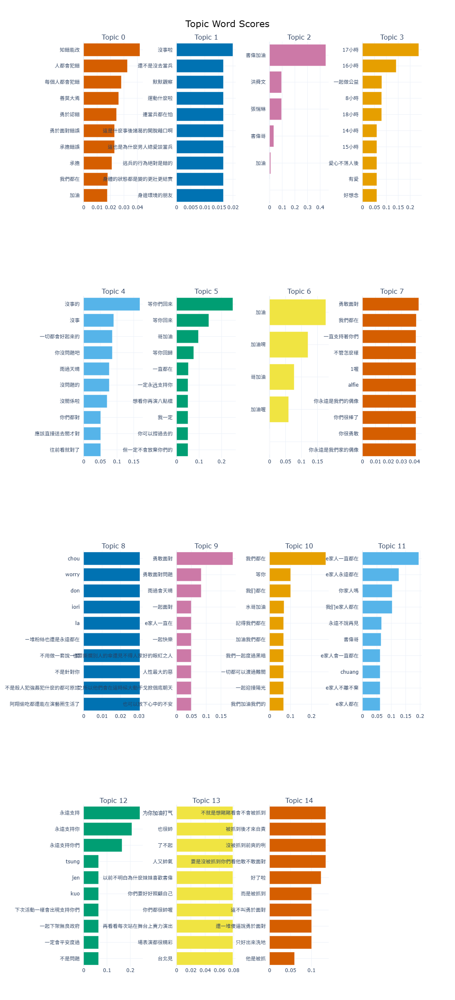

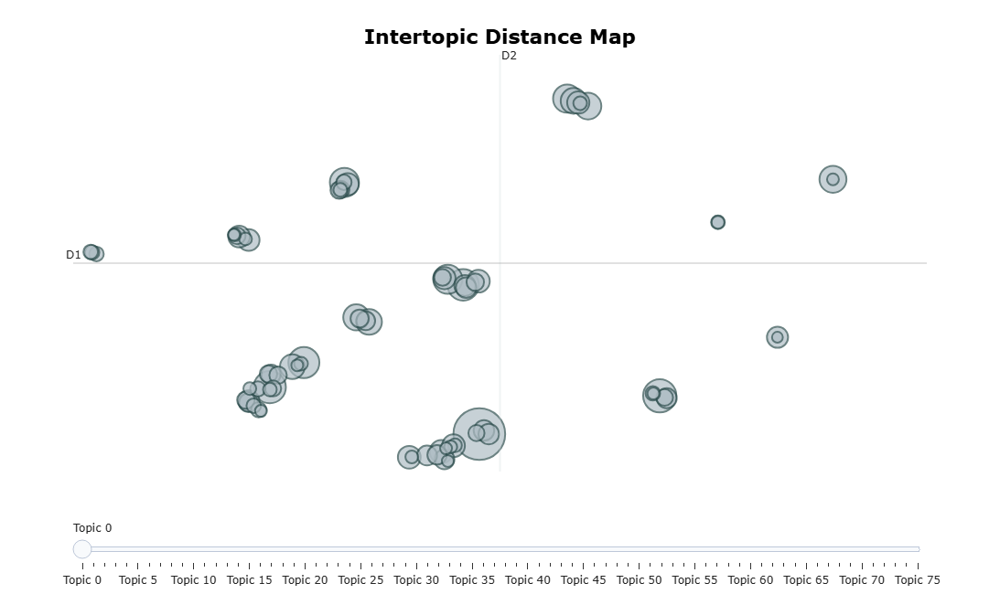

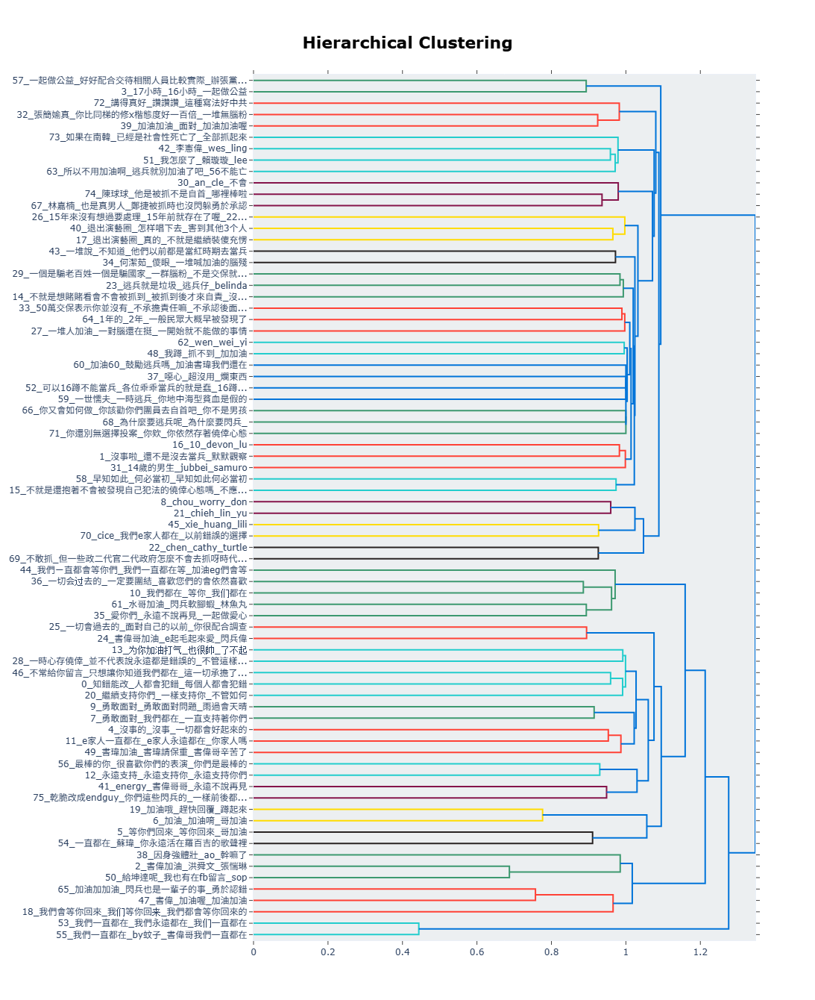

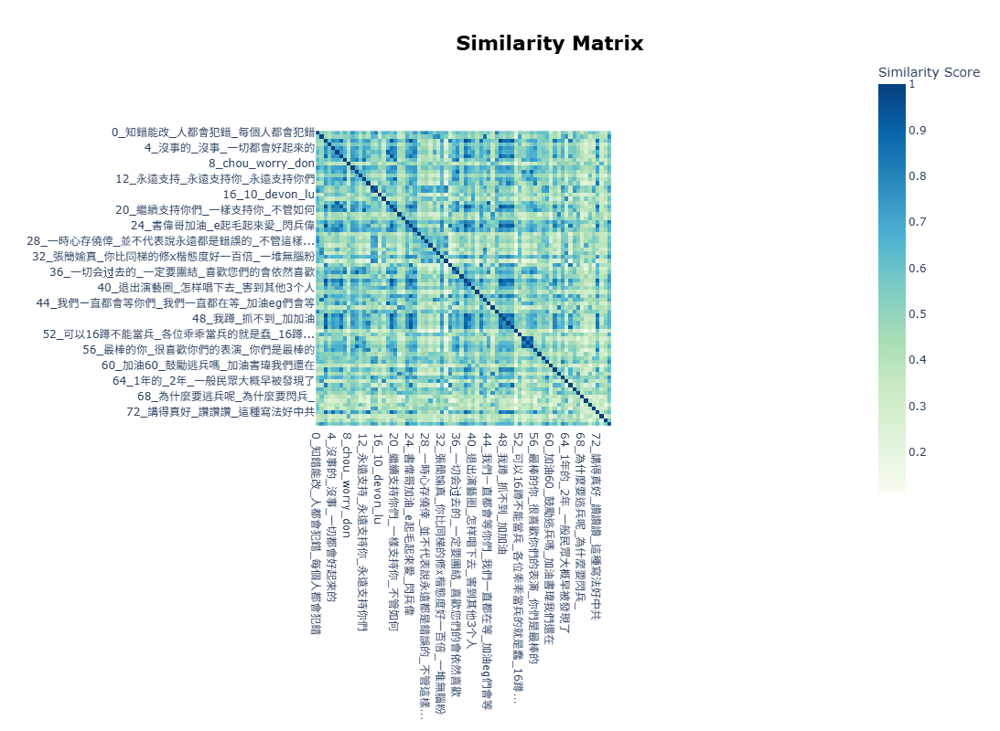

2025-12-23 14:23:50,641 - BERTopic - Embedding - Transforming documents to embeddings.


成功提取出王大陸的留言至comment_cleaned


Batches: 100%|██████████| 51/51 [00:06<00:00,  7.31it/s]
2025-12-23 14:23:57,633 - BERTopic - Embedding - Completed ✓
2025-12-23 14:23:57,633 - BERTopic - Dimensionality - Fitting the dimensionality reduction algorithm
2025-12-23 14:24:01,657 - BERTopic - Dimensionality - Completed ✓
2025-12-23 14:24:01,657 - BERTopic - Cluster - Start clustering the reduced embeddings
2025-12-23 14:24:01,685 - BERTopic - Cluster - Completed ✓
2025-12-23 14:24:01,685 - BERTopic - Representation - Fine-tuning topics using representation models.
2025-12-23 14:24:01,719 - BERTopic - Representation - Completed ✓


   Topic  Count                                               Name  \
0     -1    442                            -1_逃兵_寶靈魔法學院_我的逃兵時代_you   
1      0     67               0_打司機_如果不靠家裡面媽寶_家裡面有錢就這麼自我優越嗎_你的演技真菜   
2      1     44                             1_世界承认了吗_結果_联合国_台湾是国家吗   
3      2     42                                2_真是垃圾_垃圾人_垃圾_盤子假流氓   
4      3     35                                 3_殺人未遂_哈哈哈_1年的_wes   
5      4     33                               4_chen_sheng_wen_tom   
6      5     31                                 5_丟臉_丟臉死了_大頭症_下西下症   
7      6     31                                   6_he_his_have_by   
8      7     29                              7_幹你娘_阮大常_不敢說的事實_デ胖大衛   
9      8     26  8_逃兵還教唆打人_一個逃兵役外加教唆打人的fw怎麼還有臉活著_不是打這個就是打那個_也算是...   

                                      Representation  \
0  [逃兵, 寶靈魔法學院, 我的逃兵時代, you, lin, 3年, is, 退出演藝圈, ...   
1  [打司機, 如果不靠家裡面媽寶, 家裡面有錢就這麼自我優越嗎, 你的演技真菜, 真是厲害, ...   
2  [世界承认了吗, 結果, 联合国, 台湾是国家吗, 别自己打自己脸, 事非不分, 他台灣國籍...   
3  [真

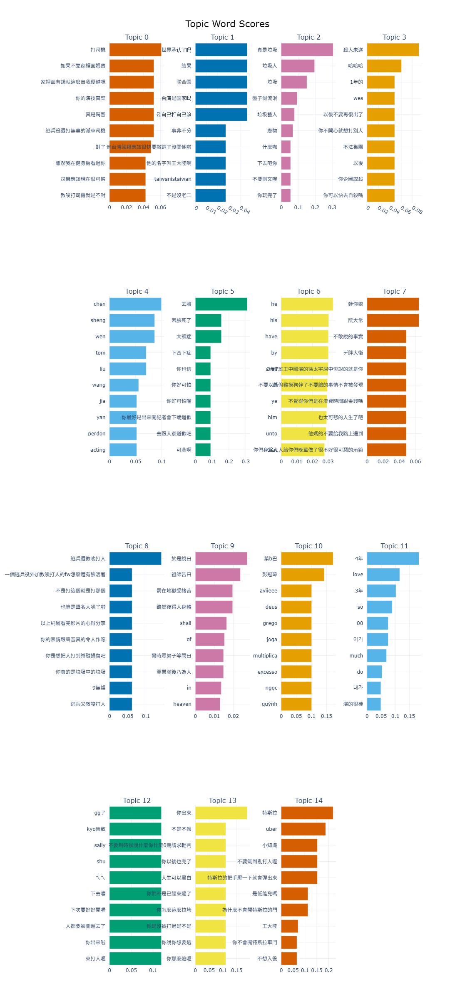

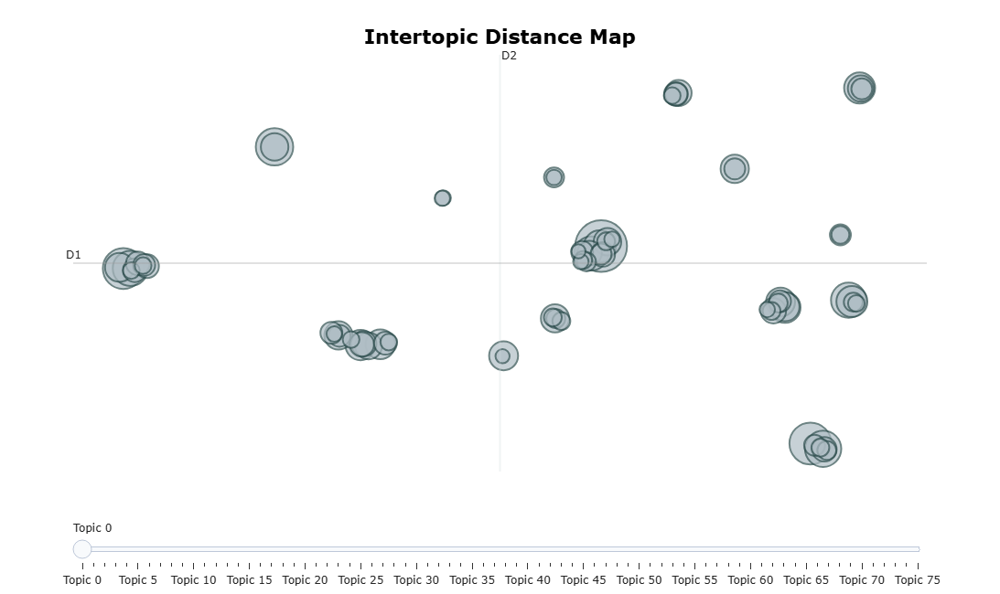

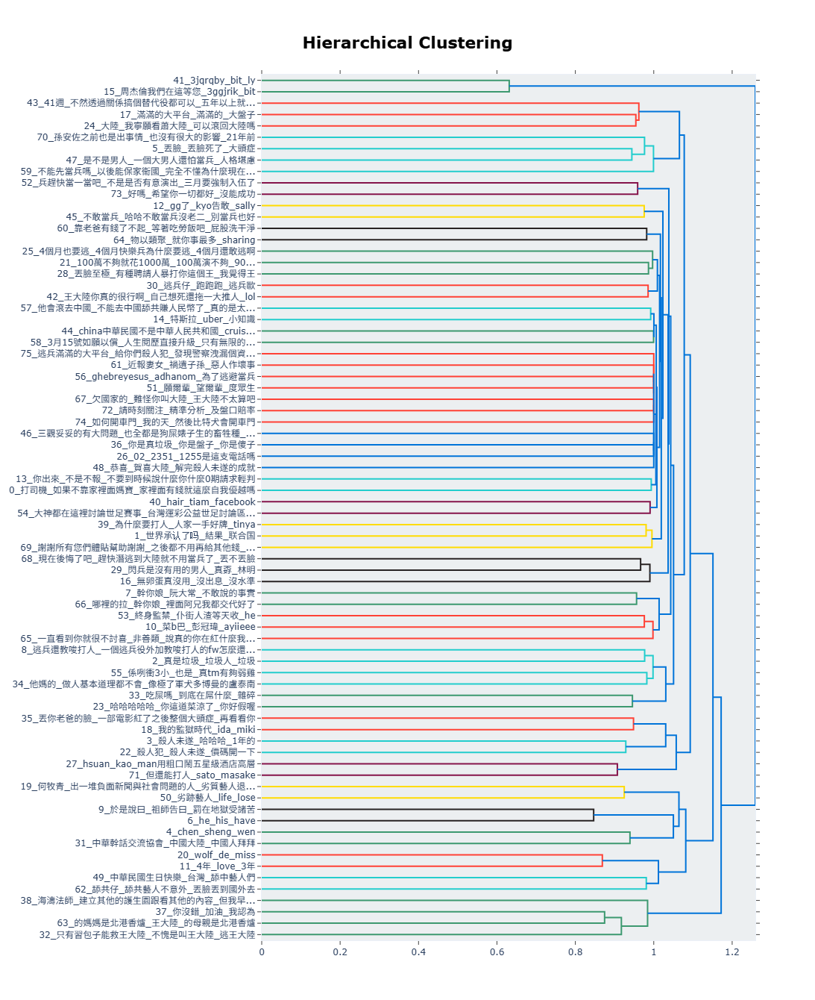

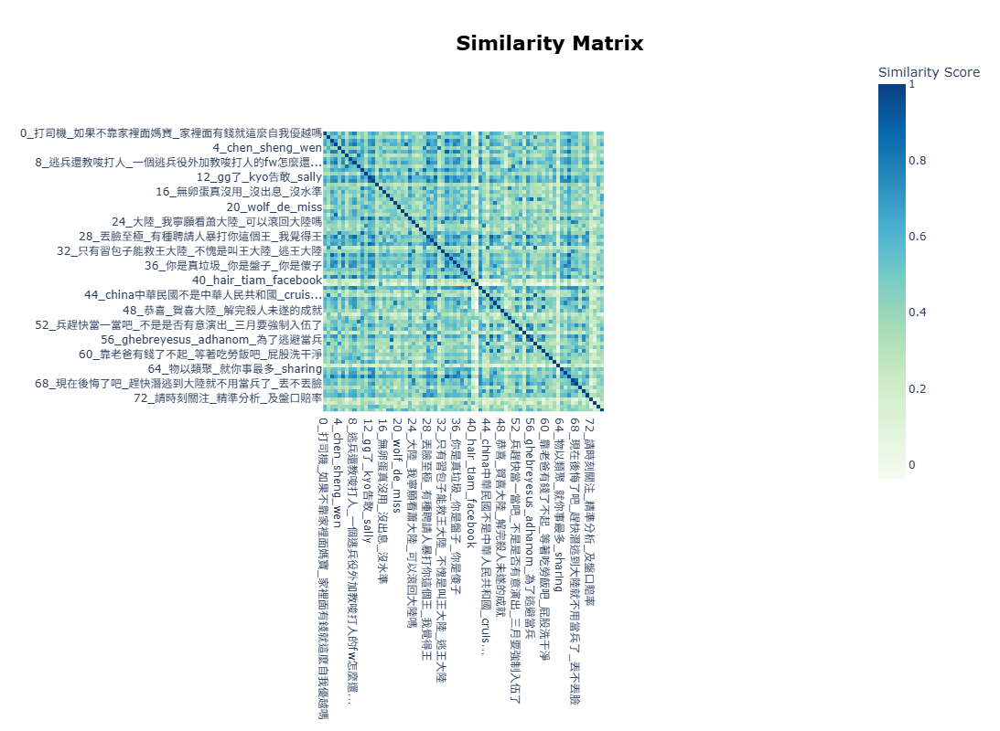

2025-12-23 14:24:02,300 - BERTopic - Embedding - Transforming documents to embeddings.


成功提取出謝坤達的留言至comment_cleaned


Batches: 100%|██████████| 14/14 [00:01<00:00,  7.36it/s]
2025-12-23 14:24:04,214 - BERTopic - Embedding - Completed ✓
2025-12-23 14:24:04,214 - BERTopic - Dimensionality - Fitting the dimensionality reduction algorithm
2025-12-23 14:24:04,881 - BERTopic - Dimensionality - Completed ✓
2025-12-23 14:24:04,882 - BERTopic - Cluster - Start clustering the reduced embeddings
2025-12-23 14:24:04,892 - BERTopic - Cluster - Completed ✓
2025-12-23 14:24:04,894 - BERTopic - Representation - Fine-tuning topics using representation models.
2025-12-23 14:24:04,907 - BERTopic - Representation - Completed ✓


   Topic  Count                            Name  \
0     -1     90   -1_年滿18歲至屆滿36歲之男子為_簡稱_徵兵檢查_閃兵   
1      0     49  0_還在外面裝瘋賣傻_有誠意悔改就進去關_知錯能改_裝病逃兵   
2      1     36         1_坤達加油_chih_hsuan_huang   
3      2     27             2_加油_等你回來_一切會過去的_坤達   
4      3     21       3_中秋佳節快樂_中秋節快樂_祝福你_中秋佳節愉快   
5      4     21            4_達老闆_8週_中秋節快樂_好想要袋子   
6      5     20                   5_ao_so_たて_わく   
7      6     19      6_永遠支持你_坤達加油_一樣支持你_不管發生什麼事   
8      7     18              7_def_逃兵仔_可悲逃兵仔_oh   
9      8     18            8_不能當兵_閃兵團_不裝盲囉_不用當兵   

                                      Representation  \
0  [年滿18歲至屆滿36歲之男子為, 簡稱, 徵兵檢查, 閃兵, 也是國防安全的保障, 依妨害...   
1  [還在外面裝瘋賣傻, 有誠意悔改就進去關, 知錯能改, 裝病逃兵, 加油, 善莫大焉, 何來...   
2  [坤達加油, chih, hsuan, huang, chiang, chiu, meime...   
3  [加油, 等你回來, 一切會過去的, 坤達, 坤達加油, e家都會一直在等你們, 關關不難過...   
4  [中秋佳節快樂, 中秋節快樂, 祝福你, 中秋佳節愉快, 達老板, 達帥, 坤達中秋節快樂,...   
5  [達老闆, 8週, 中秋節快樂, 好想要袋子, 達達中秋節快樂, 中秋佳節快樂, da手提袋...   
6  [ao, so, たて, わく, 下車瞜, 先卡位開戲, 別復出了, 別跑啊, 加油喔

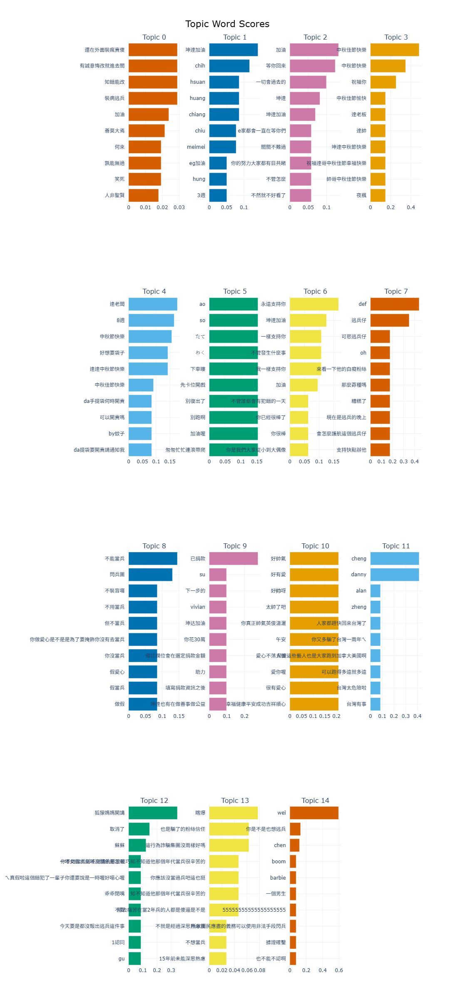

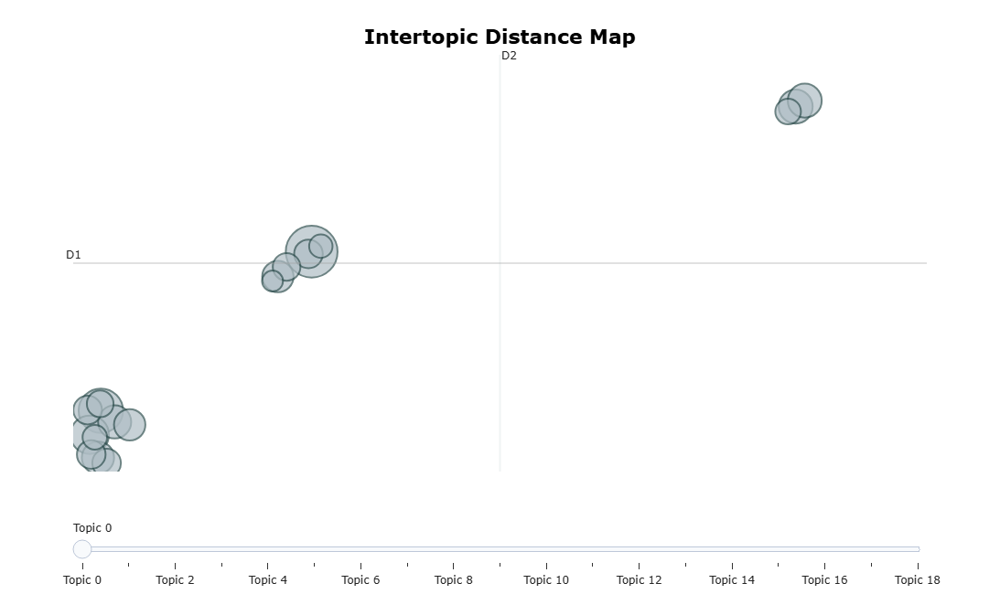

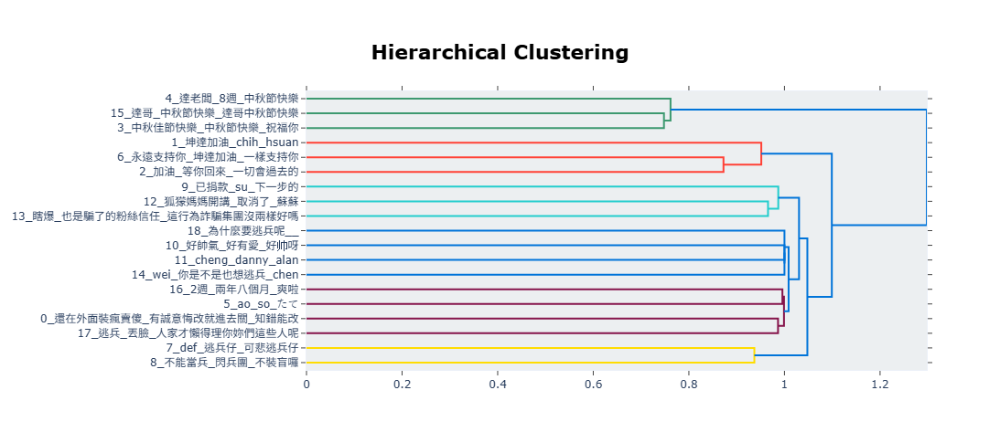

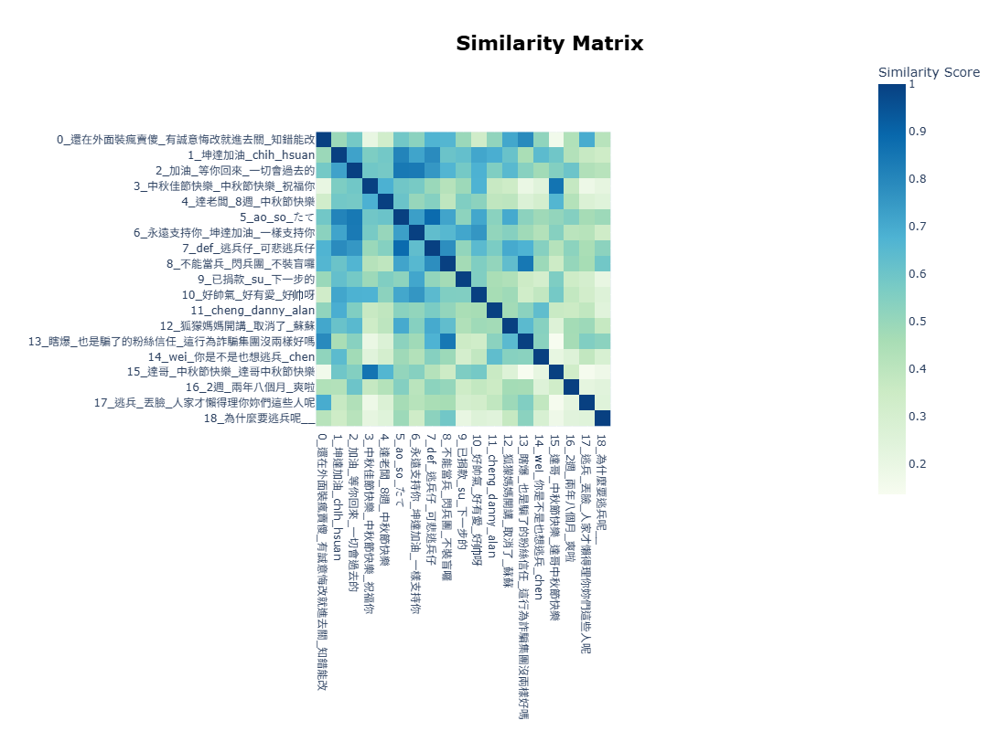

2025-12-23 14:24:05,267 - BERTopic - Embedding - Transforming documents to embeddings.


成功提取出阿達的留言至comment_cleaned


Batches: 100%|██████████| 4/4 [00:00<00:00,  8.46it/s]
2025-12-23 14:24:05,750 - BERTopic - Embedding - Completed ✓
2025-12-23 14:24:05,750 - BERTopic - Dimensionality - Fitting the dimensionality reduction algorithm
2025-12-23 14:24:05,914 - BERTopic - Dimensionality - Completed ✓
2025-12-23 14:24:05,915 - BERTopic - Cluster - Start clustering the reduced embeddings
2025-12-23 14:24:05,921 - BERTopic - Cluster - Completed ✓
2025-12-23 14:24:05,922 - BERTopic - Representation - Fine-tuning topics using representation models.
2025-12-23 14:24:05,931 - BERTopic - Representation - Completed ✓


   Topic  Count                                      Name  \
0     -1     25  -1_阿达和lulu拍的金门节目现在还记得_怎么就分手了_影片有店名啊_那么相配   
1      0     30                          0_瑞芳_米樂冠_chen_3號   
2      1     22                   1_66小吃_胡記臭豆腐_66小吃店_66好吃   
3      2     21    2_30萬交保_一臉廢物樣_你到底有啥好逃的_倀助逆x風窮爸生更多小孩來淒慘   
4      3     11                 3_謝謝_傅員外_拜託不要報_這間也可以被你找到喔   
5      4      8               4_3週_丟臉_來罵他的也很少_你覺得可不可以屌打三哥   
6      5      7                   5_4週_江香蘭_蘇輝源_看其他網友有沒有線索   

                                      Representation  \
0  [阿达和lulu拍的金门节目现在还记得, 怎么就分手了, 影片有店名啊, 那么相配, 建議退...   
1  [瑞芳, 米樂冠, chen, 3號, 224新北市瑞芳區魚桀魚坑路195, feng, h...   
2  [66小吃, 胡記臭豆腐, 66小吃店, 66好吃, 不好吃不好吃, 1週, 大胖, 以前經...   
3  [30萬交保, 一臉廢物樣, 你到底有啥好逃的, 倀助逆x風窮爸生更多小孩來淒慘, 兵役的問...   
4  [謝謝, 傅員外, 拜託不要報, 這間也可以被你找到喔, 拜託老闆不要講閃兵, 在哪裡, 請...   
5  [3週, 丟臉, 來罵他的也很少, 你覺得可不可以屌打三哥, 允悲, 因為根本沒人認識, 就...   
6  [4週, 江香蘭, 蘇輝源, 看其他網友有沒有線索, 謝謝你, 求地址, 靠近傑魚坑, 沒地...   

                                 Representative_Docs  
0  [這種影

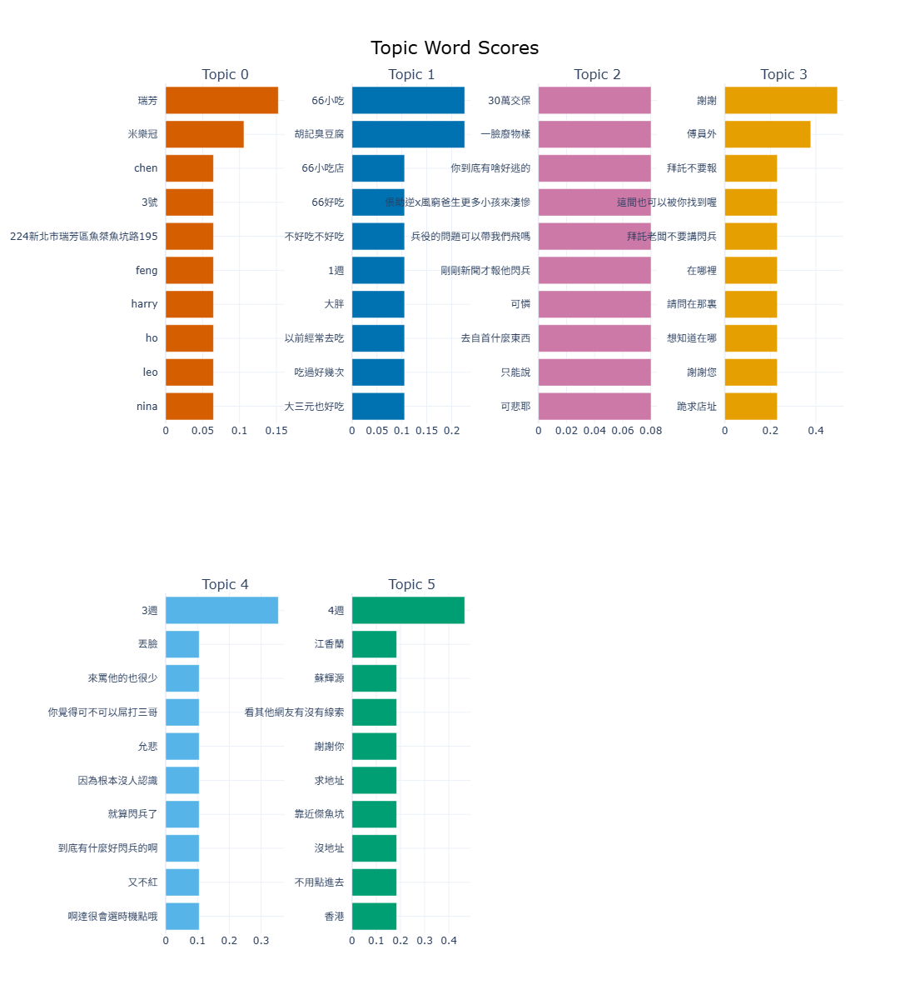

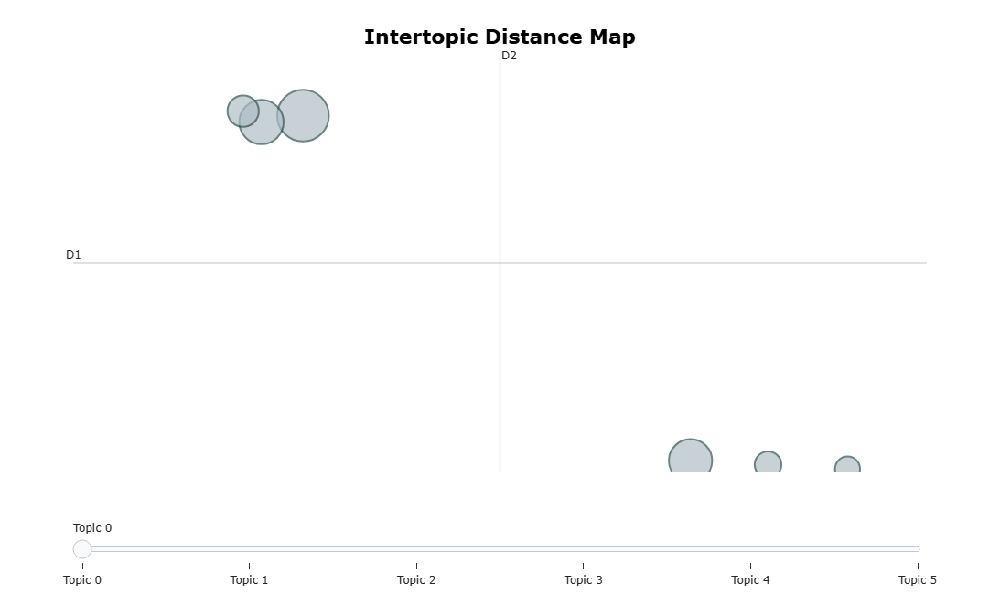

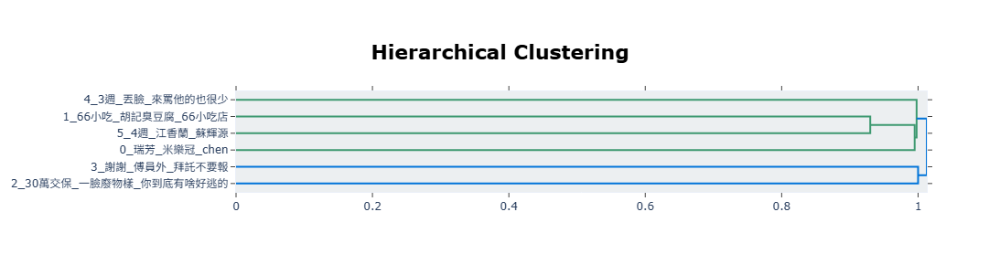

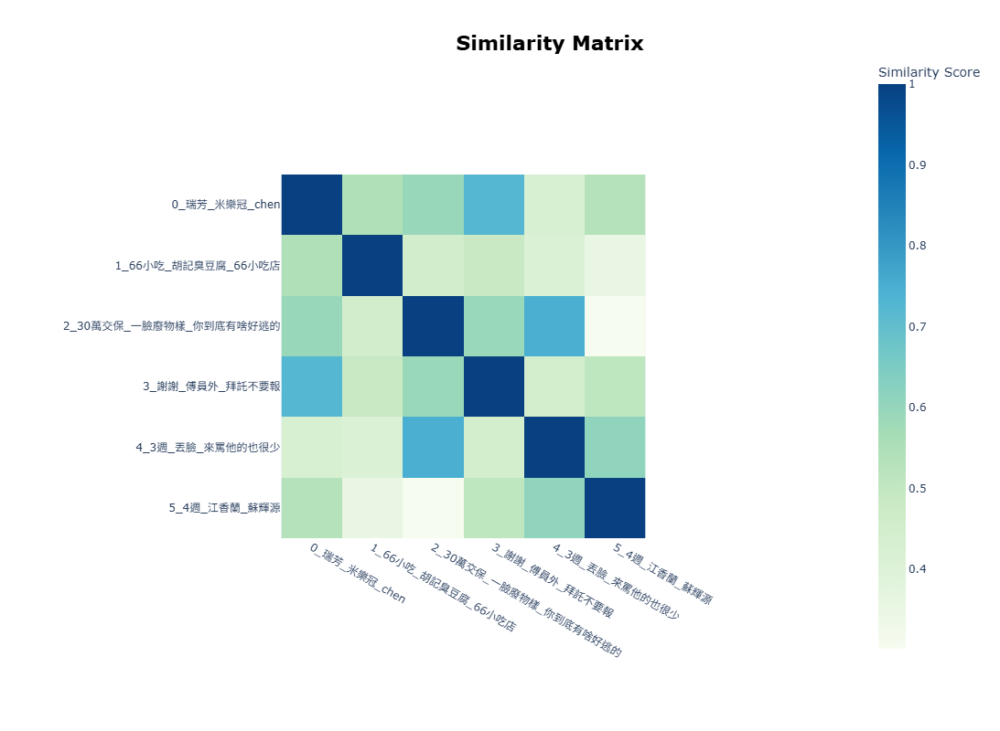

2025-12-23 14:24:06,289 - BERTopic - Embedding - Transforming documents to embeddings.


成功提取出陳零九的留言至comment_cleaned


Batches: 100%|██████████| 26/26 [00:02<00:00,  9.97it/s]
2025-12-23 14:24:08,911 - BERTopic - Embedding - Completed ✓
2025-12-23 14:24:08,912 - BERTopic - Dimensionality - Fitting the dimensionality reduction algorithm
2025-12-23 14:24:10,773 - BERTopic - Dimensionality - Completed ✓
2025-12-23 14:24:10,773 - BERTopic - Cluster - Start clustering the reduced embeddings
2025-12-23 14:24:10,800 - BERTopic - Cluster - Completed ✓
2025-12-23 14:24:10,802 - BERTopic - Representation - Fine-tuning topics using representation models.
2025-12-23 14:24:10,828 - BERTopic - Representation - Completed ✓


   Topic  Count                                  Name  \
0     -1    204            -1_cing_lin_愛嚼檳榔的哲哲_還有德州撲克   
1      0     80              0_當兵了嗎_當兵不可恥_乖乖當兵啦_被抓別再演   
2      1     51            1_閃起來_再跑啊_吳侑恩_09該面對的還是得面對啊   
3      2     38  2_你真的很屌_韭哥_自從nft之後什麼都有你的份_下場大概比王大陸更慘   
4      3     37           3_閃兵_0尬一起_nft也超成功收割_一堆垃圾丟臉呢   
5      4     25                     4_逃兵九_09_00_09差九九   
6      5     23            5_又是你_09又是你_09我對你愛愛不完_一定是你   
7      6     22  6_看新聞來的_0有關的是是誰_上社會新聞了耶_下次再出現新聞版面的時候   
8      7     22                     7_置板凳_秋九_卡板凳_置板凳中   
9      8     19          8_永遠放下藝人身分吧_逃兵真牛逼_要是真的_一堆代表作   

                                      Representation  \
0  [cing, lin, 愛嚼檳榔的哲哲, 還有德州撲克, eason, 你很急喔, 就算全世...   
1  [當兵了嗎, 當兵不可恥, 乖乖當兵啦, 被抓別再演, 枉費這身, 裝病又一遍, 該怎麼進退...   
2  [閃起來, 再跑啊, 吳侑恩, 09該面對的還是得面對啊, 你旁邊位子有人嗎, 你可以試試就...   
3  [你真的很屌, 韭哥, 自從nft之後什麼都有你的份, 下場大概比王大陸更慘, 也沒看你們自...   
4  [閃兵, 0尬一起, nft也超成功收割, 一堆垃圾丟臉呢, 一般判都是幾個月易科罰金, k...   
5  [逃兵九, 09, 00, 09差九九, 09發限動了, 0一個,

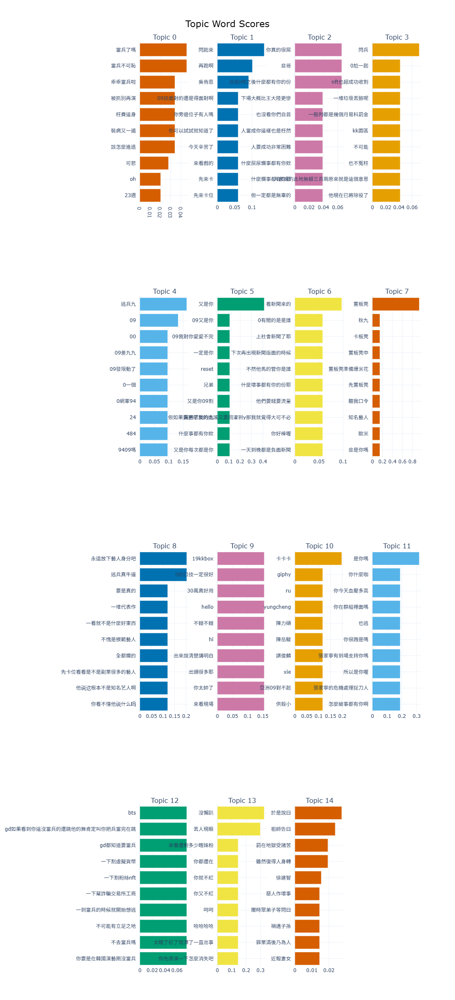

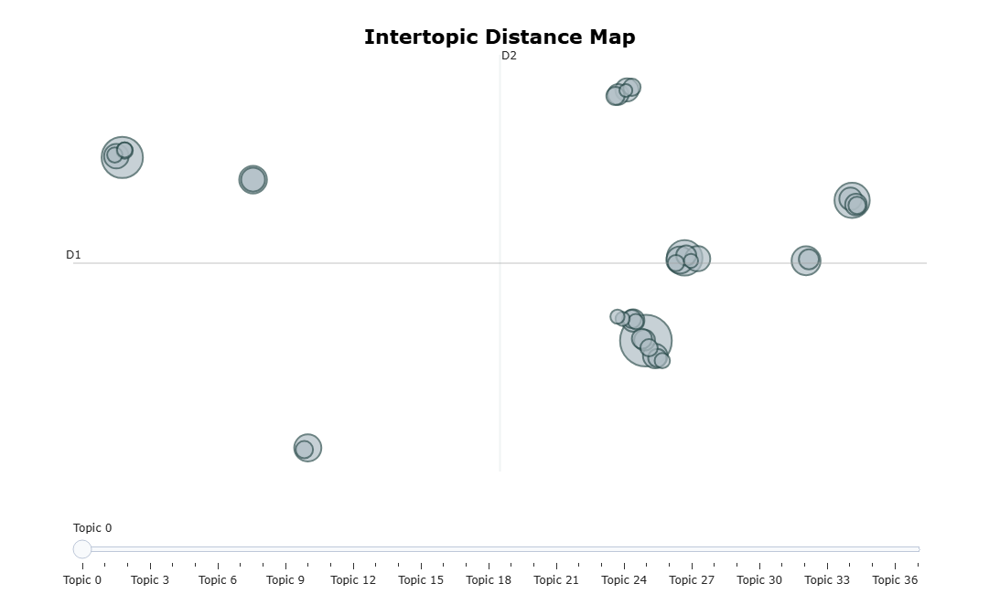

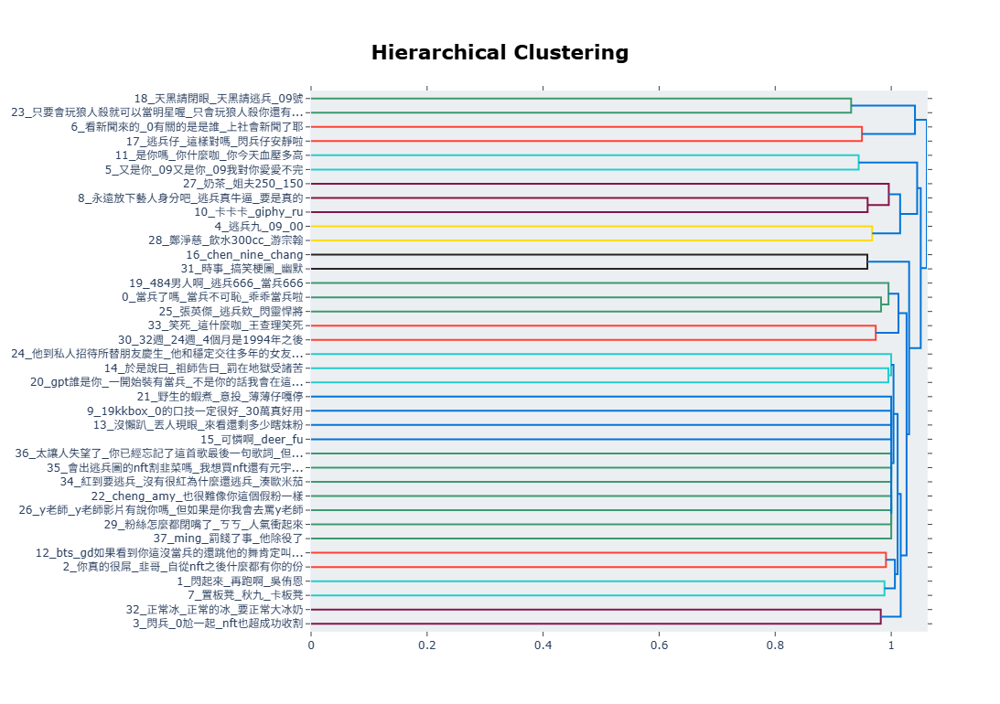

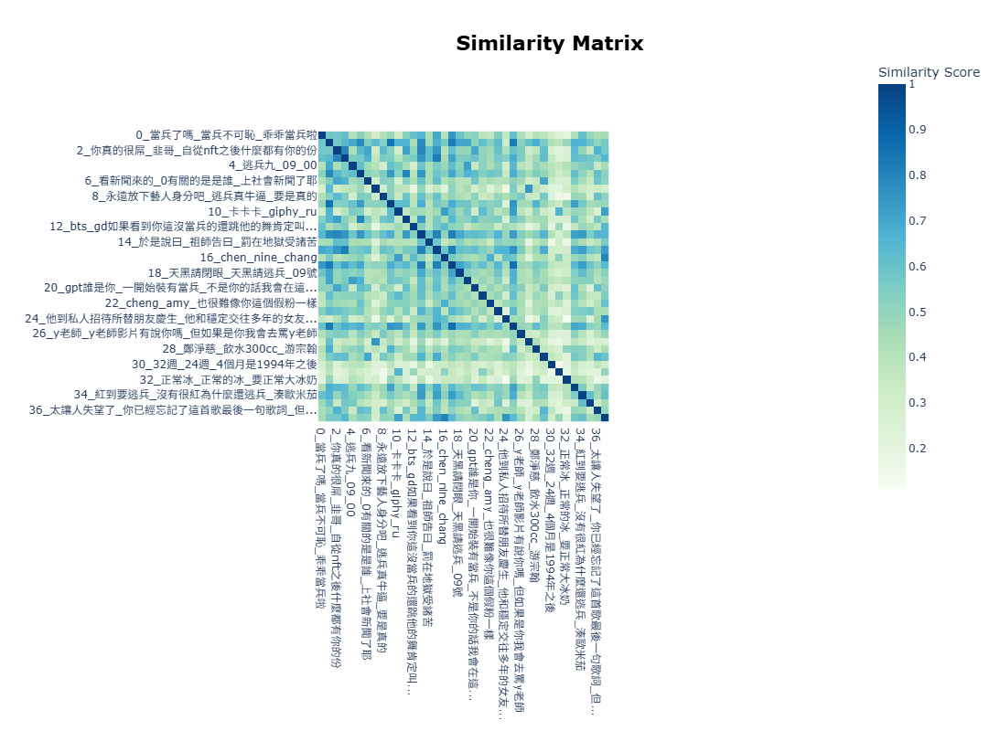


All Done!


In [39]:
for artist in comments_dict:
    # 把留言中的url刪掉
    comments_cleaned = [clean_text(str(c)) for c in comments_dict[artist] if len(clean_text(str(c))) > 2]
    print(f"成功提取出{artist}的留言至comment_cleaned")

    min_size = int(len(comments_cleaned) * 0.0005)
    if min_size < 2:
        min_size = 5

    # min_cluster_size: 一個主題最少要有幾則留言 (可根據資料量調整)
    hdbscan_model = HDBSCAN(min_cluster_size=min_size, metric='euclidean', cluster_selection_method='eom', prediction_data=True)


    #############
    # Training
    #############
    topic_model = BERTopic(
        embedding_model=embedding_model,
        umap_model=umap_model,
        hdbscan_model=hdbscan_model,
        vectorizer_model=vectorizer_model,
        verbose=True
    )
    
    topics, probs = topic_model.fit_transform(comments_cleaned)
    '''
    #########################################################################
    # 如果Topic=-1的文本太多了，執行以下程式，把一些outliers分到最靠近的群體裏面
    #########################################################################
    
    # 將離群值分配給最相似的主題
    new_topics = topic_model.reduce_outliers(comments_cleaned, topics)
    
    # 更新模型中的主題標籤
    topic_model.update_topics(comments_cleaned, topics=new_topics)
    '''
    ###################
    # 結果（文字）　
    ###################
    
    # 取得主題清單 (-1 代表雜訊/不屬於任何主題)
    topic_info = topic_model.get_topic_info()
    print(topic_info.head(10))
    
    # 儲存結果
    folder_path = "hbdscan_topics_result_idividual_csv"

    if not os.path.exists(folder_path):
        os.makedirs(folder_path)
    
    topic_info.to_csv(f"hbdscan_topics_result_idividual_csv/hdbscan_topics_{platform_name}_{artist}.csv", index=False, encoding="utf-8-sig")
    print(f"儲存{artist}的結果到",f"hdbscan_topics_{platform_name}_{artist}.csv")

    ###############
    # 圖形化顯示
    ###############
    folder_path = f"hbdscan_topics_result_idividual_graphs_/{artist}/{platform_name}"

    if not os.path.exists(folder_path):
        os.makedirs(folder_path)
    
    # top_n_topics: 顯示前幾個主題
    # n_words: 每個主題顯示幾個關鍵字
    fig1 = topic_model.visualize_barchart(top_n_topics=15, n_words=10, height=600)
    fig1.show()
    
    # 儲存為 HTML 檔（可以用瀏覽器開啟，保留互動功能）
    fig1.write_html(f"hbdscan_topics_result_idividual_graphs_/{artist}/{platform_name}/topic_barchart_{platform_name}_{artist}.html")
    
    # intertopic distance map
    fig2 = topic_model.visualize_topics()
    fig2.show()
    fig2.write_html(f"hbdscan_topics_result_idividual_graphs_/{artist}/{platform_name}/topic_distance_map_{platform_name}_{artist}.html")
    
    # Hierarchy
    fig3 = topic_model.visualize_hierarchy()
    fig3.show()
    fig3.write_html(f"hbdscan_topics_result_idividual_graphs_/{artist}/{platform_name}/topic_hierarchy_{platform_name}_{artist}.html")
    
    # Heat Map
    fig4 = topic_model.visualize_heatmap()
    fig4.show()
    fig4.write_html(f"hbdscan_topics_result_idividual_graphs_/{artist}/{platform_name}/topic_heatmap_{platform_name}_{artist}.html")

print()
print("All Done!")